In [1]:
import math
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import torch
from transformers import BertTokenizer, BertForSequenceClassification
import pandas as pd

W0622 20:42:46.454769 74899 torch/distributed/elastic/multiprocessing/redirects.py:29] NOTE: Redirects are currently not supported in Windows or MacOs.


In [2]:
hyperparams = {
    'netifier': {
        'path': '../multi-label-active-learning/dataset/netifier/data/train.csv',
        'sequence_length': 96,
        'data_count': 7773,
        'batch_size': 32,
        'text_col': 6,
        'label_col_start': 2,
        'label_col_end': 6,
        'labels': ['pornografi', 'sara', 'radikalisme', 'pencemaran_nama_baik'],
        'model_index': {
            'lc': 1,
            'mc': 1,
            'kmeans': 4,
            'coreset': 2,
            'besra': 3,
            'comal': 1,
            'random': 1,
        }
    },
    'dat': {
        'path': '../multi-label-active-learning/dataset/Doctors Answer Text Dataset in Indonesian Contains Information on Medical Interview Patterns/Indo-Online Health Consultation-Medical Interview-Clean.csv',
        'sequence_length': 192,
        'data_count': 500,
        'batch_size': 4,
        'text_col': 8,
        'label_col_start': 2,
        'label_col_end': 8,
        'labels': ['1-FR', '2-GI', '3-PI', '4-DM', '5-EDTRB', '6-RE'],
        'model_index': {
            'lc': 4,
            'mc': 5,
            'kmeans': 5,
            'coreset': 2,
            'besra': 2,
            'comal': 5,
            'random': 2,
        }
    },
    'hsd': {
        'path': '../multi-label-active-learning/dataset/id-multi-label-hate-speech-and-abusive-language-detection/re_dataset.csv',
        'sequence_length': 80,
        'data_count': 13169,
        'batch_size': 64,
        'text_col': 0,
        'label_col_start': 1,
        'labels': ['HS', 'Abusive', 'HS_Individual', 'HS_Group', 'HS_Religion', 'HS_Race', 'HS_Physical', 'HS_Gender', 'HS_Other', 'HS_Weak', 'HS_Moderate', 'HS_Strong'],
        'model_index': {
            'lc': 3,
            'mc': 2,
            'kmeans': 5,
            'coreset': 4,
            'besra': 5,
            'comal': 1,
            'random': 4,
        }
    },
    'casa': {
        'path': '../multi-label-active-learning/dataset/CASA/test_preprocess.csv',
        'sequence_length': 48,
        'data_count': 1080,
        'batch_size': 16,
        'text_col': 0,
        'label_col_start': 1,
        'aspects': ['fuel', 'machine', 'others', 'part', 'price', 'service'],
        'model_index': {
            'lc': 1,
            'mc': 2,
            'kmeans': 3,
            'coreset': 3,
            'besra': 3,
            'comal': 5,
            'random': 2,
        }
    },
    'hoasa': {
        'path': '../multi-label-active-learning/dataset/HoASA/test_preprocess.csv',
        'sequence_length': 48,
        'data_count': 2854,
        'batch_size': 16,
        'text_col': 0,
        'label_col_start': 1,
        'aspects': ['ac', 'air_panas', 'bau', 'general', 'kebersihan', 'linen', 'service', 'sunrise_meal', 'tv', 'wifi'],
        'model_index': {
            'lc': 5,
            'mc': 3,
            'kmeans': 4,
            'coreset': 1,
            'besra': 1,
            'comal': 4,
            'random': 5,
        }
    },
}

strategies = ['LC', 'MC', 'Coreset', 'KMeans', 'BESRA', 'CoMAL', 'Random']

def get_dataset_hyperparameters(dataset: str):
    return hyperparams[dataset] if dataset in hyperparams else None

In [3]:
def load_data(dataset, query_strategy, percentage):
    hyperparams = get_dataset_hyperparameters(dataset)
    if percentage <= 0.5:
        data_count = int(math.floor(0.5 * hyperparams['data_count']))
    else:
        data_count = int(math.floor(percentage * hyperparams['data_count']))
    max_data_count = int(math.floor(0.8 * hyperparams['data_count']))
    acq_data = pd.read_csv(f'./../{dataset}/acquired_data/{dataset}-{query_strategy}-1-data-{data_count}.csv')
    ori_data = pd.read_csv(f'./../{dataset}/acquired_data/{dataset}-lc-1-data-{max_data_count}.csv')

    acq_data = acq_data.iloc[:int(math.floor(percentage * hyperparams['data_count']))]
    ori_data = ori_data.iloc[:max_data_count]

    label_columns = acq_data.columns[1:]

    return acq_data, ori_data, label_columns

In [4]:
def count_label_occurences(df, labels, label_to_find=1, subclasses=None):
    if subclasses is not None:
        count = {label: {subclass: 0 for subclass in subclasses} for label in labels}
    else:
        count = {label: 0 for label in labels}

    for i in range(df.shape[0]):
        data = df.iloc[i]
        for label in labels:
            if subclasses:
                if type(data[label]) != str:
                    continue
                count[label][data[label]] += 1
            elif data[label] == label_to_find:
                count[label] += 1

    return count

In [5]:
def count_difference(acq_data, ori_data, label_columns, subclasses=None, label_to_find=1):
    acq_label_count = count_label_occurences(acq_data, label_columns, label_to_find, subclasses)
    print(acq_label_count)

    ori_label_count = count_label_occurences(ori_data, label_columns, label_to_find, subclasses)
    print(ori_label_count)

    if subclasses is not None:
        difference = {
            label: {subclass: ori_label_count[label][subclass] - acq_label_count[label][subclass] for subclass in subclasses} 
            for label in label_columns
        }
    else:
        difference = {
            'acquired': [acq_label_count[label] for label in label_columns],
            'difference': [ori_label_count[label] - acq_label_count[label] for label in label_columns],
        }

    return acq_label_count, ori_label_count, difference

In [6]:
# Function to calculate imbalance ratio for a column
def calculate_imbalance_ratio(column):
    value_counts = column.value_counts()
    value_counts.drop('neg_pos', inplace=True, errors='ignore')

    max_count = value_counts.max()
    min_count = value_counts.min()

    return max_count / min_count if min_count > 0 else float('inf')

In [22]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from transformers import AutoTokenizer, AutoModel, BertForSequenceClassification
import torch
from sklearn.manifold import TSNE
from sklearn.manifold import trustworthiness

def plot_feature_space(dataset, strategies, percentage):
    hyperparams = get_dataset_hyperparameters(dataset)

    if percentage <= 0.5:
        data_count = int(math.floor(0.5 * hyperparams['data_count']))
    else:
        data_count = int(math.floor(percentage * hyperparams['data_count']))
    max_data_count = int(math.floor(0.8 * hyperparams['data_count']))

    # 1. Load your data
    full_df = pd.read_csv(f'./../{dataset}/acquired_data/{dataset}-lc-1-data-{max_data_count}.csv')
    label_columns = full_df.columns[1:]
    # full_df = full_df[full_df['sara'] == 1]
    # full_df = full_df[full_df['sara'] == 0]
    full_df = full_df[(full_df[label_columns] != 0).any(axis=1)]

    #  2. Initialize IndoBERT
    tokenizer = AutoTokenizer.from_pretrained("indobenchmark/indobert-base-p1")
    model = BertForSequenceClassification.from_pretrained(f"./../{dataset}/models/{dataset}-passive-model").to(torch.device("mps"))
    # model = BertForSequenceClassification.from_pretrained(f"./../{dataset}/models/{dataset}-kmeans-1-model-50").to(torch.device("mps"))
    model.eval()

    def embed_texts(texts, batch_size=32, device="mps"):
        all_embs = []
        for i in range(0, len(texts), batch_size):
            batch = tokenizer(texts[i : i+batch_size], padding=True, truncation=True, return_tensors="pt", max_length=96).to(device)
            with torch.no_grad():
                out = model.base_model(**batch.to(device))
            embs = out.last_hidden_state[:, 0, :].cpu().numpy()
            all_embs.append(embs)
        return np.vstack(all_embs)

    # 3. Compute embeddings
    texts_full = full_df["processed_text"].tolist()
    X_full = embed_texts(texts_full)

    # 4. Standardize
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X_full)

    fig, axes = plt.subplots(4, 2, figsize=(20, 20), sharex=True)
    x = np.arange(len(label_columns))

    # 5. TSNE → 2D
    tsne = TSNE(
        n_components=2,
        perplexity=30,
        max_iter=1000,
        learning_rate='auto',
        init='pca',
        random_state=42,
    )
    X_tsne = tsne.fit_transform(X_scaled)
    print("Final KL divergence:", tsne.kl_divergence_)

    trust = trustworthiness(X_scaled, X_tsne, n_neighbors=5)
    print("Trustworthiness (0–1):", trust)

    # left_side_data = [i for i, t in enumerate(texts_full) if X_tsne[i,0] < 0]
    # left_side_data = full_df.iloc[left_side_data]
    # left_side_data.to_csv('./left_side_data.csv', index=False)

    # right_side_data = [i for i, t in enumerate(texts_full) if X_tsne[i,0] >= 0]
    # right_side_data = full_df.iloc[right_side_data]
    # right_side_data.to_csv('./right_side_data.csv', index=False)

    for i, strategy in enumerate(strategies):
        ax = axes[i // 2, i % 2]

        acq_df  = pd.read_csv(f"./../{dataset}/acquired_data/{dataset}-{strategy}-1-data-{data_count}.csv")
        if percentage <= 0.5:
            acq_df = acq_df.iloc[:int(math.floor(percentage * hyperparams['data_count']))]

        # First filter acq_df
        # acq_df = acq_df[acq_df['sara'] == 1]
        
        acq_df = acq_df[(acq_df[label_columns] != 0).any(axis=1)]
        # acq_df = acq_df[acq_df['sara'] == 0]
        texts_acq = acq_df["processed_text"].tolist()

        # Find indices of acquired samples in the full pool
        acq_idx = []
        for i, t in enumerate(texts_full):
            if t in texts_acq:
                acq_idx.append(i)
                texts_acq.remove(t)

        ax.scatter(X_tsne[:,0], X_tsne[:,1], alpha=0.2, label="pool")

        print(f"Acquired data count for {strategy}:", len(acq_idx))

        # acq_idx = [i for i, t in enumerate(texts_full) if t in texts_acq and X_tsne[i,0] >= 0]
        ax.scatter(
            X_tsne[acq_idx,0],
            X_tsne[acq_idx,1],
            c="C1",
            s=30,
            label="acquired",
            alpha=0.8
        )
        ax.set_title(strategy.upper())
        ax.legend()
    
    axes.flat[-1].axis('off')
    plt.show()

# PLOT FEATURE SPACE

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from transformers import AutoTokenizer, AutoModel, BertForSequenceClassification
import torch
from sklearn.manifold import TSNE
from sklearn.manifold import trustworthiness

def plot_feature_space(dataset, strategies, percentage):
    hyperparams = get_dataset_hyperparameters(dataset)

    if percentage <= 0.5:
        data_count = int(math.floor(0.5 * hyperparams['data_count']))
    else:
        data_count = int(math.floor(percentage * hyperparams['data_count']))
    max_data_count = int(math.floor(0.8 * hyperparams['data_count']))

    # 1. Load your data
    full_df = pd.read_csv(f'./../{dataset}/acquired_data/{dataset}-lc-1-data-{max_data_count}.csv')
    label_columns = full_df.columns[1:]
    # full_df = full_df[(full_df[label_columns] == 1).any(axis=1)]
    # full_df = full_df[(full_df[label_columns] == 0).all(axis=1)]

    #  2. Initialize IndoBERT
    tokenizer = AutoTokenizer.from_pretrained("indobenchmark/indobert-base-p1")
    model = BertForSequenceClassification.from_pretrained(f"./../{dataset}/models/{dataset}-passive-model").to(torch.device("mps"))
    model.eval()

    def embed_texts(texts, batch_size=32, device="mps"):
        all_embs = []
        for i in range(0, len(texts), batch_size):
            batch = tokenizer(texts[i : i+batch_size], padding=True, truncation=True, return_tensors="pt", max_length=96).to(device)
            with torch.no_grad():
                out = model.base_model(**batch.to(device))
            embs = out.last_hidden_state[:, 0, :].cpu().numpy()
            all_embs.append(embs)
        return np.vstack(all_embs)

    # 3. Compute embeddings
    texts_full = full_df["processed_text"].tolist()
    X_full = embed_texts(texts_full)

    # 4. Standardize
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X_full)

    fig, axes = plt.subplots(4, 2, figsize=(30, 30), sharex=True)
    x = np.arange(12)

    # 5. TSNE → 2D
    tsne = TSNE(
        n_components=2,
        perplexity=30,
        max_iter=1000,
        learning_rate='auto',
        init='pca',
        random_state=42,
    )
    X_tsne = tsne.fit_transform(X_scaled)
    print("Final KL divergence:", tsne.kl_divergence_)

    trust = trustworthiness(X_scaled, X_tsne, n_neighbors=5)
    print("Trustworthiness (0-1):", trust)

    # left_side_data = [i for i, t in enumerate(texts_full) if X_tsne[i,0] < -10 and X_tsne[i,1] < 10]
    # left_side_data = full_df.iloc[left_side_data]
    # left_side_data.to_csv('./left_side_data.csv', index=False)

    # right_side_data = [i for i, t in enumerate(texts_full) if X_tsne[i,0] >= 0]
    # right_side_data = full_df.iloc[right_side_data]
    # right_side_data.to_csv('./right_side_data.csv', index=False)

    for i, strategy in enumerate(strategies):
        ax = axes[i // 2, i % 2]

        acq_df  = pd.read_csv(f"./../{dataset}/acquired_data/{dataset}-{strategy}-1-data-{data_count}.csv")
        if percentage <= 0.5:
            acq_df = acq_df.iloc[:int(math.floor(percentage * hyperparams['data_count']))]

        # First filter acq_df
        # positive = acq_df[(acq_df[label_columns] == 1).any(axis=1)]
        # negative = acq_df[(acq_df[label_columns] == 0).all(axis=1)]

        # positive_texts = positive["processed_text"].tolist()
        # negative_texts = negative["processed_text"].tolist()

        # Find indices of acquired samples in the full pool
        pos_idx = []
        texts_acq = acq_df["processed_text"].tolist()
        for i, t in enumerate(texts_full):
            if t in texts_acq:
                pos_idx.append(i)
                
        # for i, t in enumerate(texts_full):
        #     if t in positive_texts:
        #         pos_idx.append(i)
        #         positive_texts.remove(t)

        # neg_idx = []
        # for i, t in enumerate(texts_full):
        #     if t in negative_texts:
        #         neg_idx.append(i)
        #         negative_texts.remove(t)

        ax.scatter(X_tsne[:,0], X_tsne[:,1], alpha=0.2, label="pool")

        print(f"Acquired POSITIVE data count for {strategy}:", len(pos_idx))
        # print(f"Acquired NEGATIVE data count for {strategy}:", len(neg_idx))

        ax.scatter(
            X_tsne[pos_idx,0],
            X_tsne[pos_idx,1],
            c="C1",
            s=30,
            label="acquired",
            alpha=0.8
        )
        ax.set_title(strategy.upper())
        ax.legend()
    
    axes.flat[-1].axis('off')
    plt.show()

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from transformers import AutoTokenizer, BertForSequenceClassification
import torch
from sklearn.manifold import TSNE
from sklearn.manifold import trustworthiness

def plot_absa_feature_space(dataset, strategies, percentage):
    hyperparams = get_dataset_hyperparameters(dataset)

    if percentage <= 0.5:
        data_count = int(math.floor(0.5 * hyperparams['data_count']))
    else:
        data_count = int(math.floor(percentage * hyperparams['data_count']))
    max_data_count = int(math.floor(0.8 * hyperparams['data_count']))

    # 1. Load your data
    full_df = pd.read_csv(f'./../{dataset}/acquired_data/{dataset}-lc-1-data-{max_data_count}.csv')
    label_columns = full_df.columns[1:]

    #  2. Initialize IndoBERT
    tokenizer = AutoTokenizer.from_pretrained("indobenchmark/indobert-base-p1")
    model = BertForSequenceClassification.from_pretrained(f"./../{dataset}/models/{dataset}-passive-aspect-model").to(torch.device("mps"))
    model.eval()

    def embed_texts(texts, batch_size=32, device="mps"):
        all_embs = []
        for i in range(0, len(texts), batch_size):
            batch = tokenizer(texts[i : i+batch_size], padding=True, truncation=True, return_tensors="pt", max_length=96).to(device)
            with torch.no_grad():
                out = model.base_model(**batch.to(device))
            embs = out.last_hidden_state[:, 0, :].cpu().numpy()
            all_embs.append(embs)
        return np.vstack(all_embs)

    # 3. Compute embeddings
    texts_full = full_df["processed_text"].tolist()
    X_full = embed_texts(texts_full)

    # 4. Standardize
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X_full)

    fig, axes = plt.subplots(4, 2, figsize=(30, 30), sharex=True)
    x = np.arange(12)

    # 5. TSNE → 2D
    tsne = TSNE(
        n_components=2,
        perplexity=30,
        max_iter=1000,
        learning_rate='auto',
        init='pca',
        random_state=42,
    )
    X_tsne = tsne.fit_transform(X_scaled)
    print("Final KL divergence:", tsne.kl_divergence_)

    trust = trustworthiness(X_scaled, X_tsne, n_neighbors=5)
    print("Trustworthiness (0-1):", trust)

    # left_side_data = [i for i, t in enumerate(texts_full) if X_tsne[i,0] < -10 and X_tsne[i,1] < 10]
    # left_side_data = full_df.iloc[left_side_data]
    # left_side_data.to_csv('./left_side_data.csv', index=False)

    # right_side_data = [i for i, t in enumerate(texts_full) if X_tsne[i,0] >= 0]
    # right_side_data = full_df.iloc[right_side_data]
    # right_side_data.to_csv('./right_side_data.csv', index=False)

    for i, strategy in enumerate(strategies):
        ax = axes[i // 2, i % 2]

        acq_df  = pd.read_csv(f"./../{dataset}/acquired_data/{dataset}-{strategy}-1-data-{data_count}.csv")
        if percentage <= 0.5:
            acq_df = acq_df.iloc[:int(math.floor(percentage * hyperparams['data_count']))]

        # Filter acq_df
        # positive = acq_df[(acq_df[label_columns] == 1).any(axis=1)]
        # negative = acq_df[(acq_df[label_columns] == 0).all(axis=1)]

        # positive_texts = positive["processed_text"].tolist()
        # negative_texts = negative["processed_text"].tolist()

        # print(len(negative_texts), len(positive_texts))

        # Find indices of acquired samples in the full pool
        pos_idx = []
        texts_acq = acq_df["processed_text"].tolist()
        for i, t in enumerate(texts_full):
            if t in texts_acq:
                pos_idx.append(i)
                # texts_acq.remove(t)
        # pos_idx = [i for i in range(len(texts_full))]
        # for i, t in enumerate(texts_full):
        #     if t in positive_texts:
        #         pos_idx.append(i)
        #         positive_texts.remove(t)

        # neg_idx = []
        # for i, t in enumerate(texts_full):
        #     if t in negative_texts:
        #         neg_idx.append(i)
        #         negative_texts.remove(t)

        ax.scatter(X_tsne[:,0], X_tsne[:,1], alpha=0.2, label="pool")

        print(f"Acquired POSITIVE data count for {strategy}:", len(pos_idx))
        # print(f"Acquired NEGATIVE data count for {strategy}:", len(neg_idx))

        ax.scatter(
            X_tsne[pos_idx,0],
            X_tsne[pos_idx,1],
            c="C1",
            s=30,
            label="acquired",
            alpha=0.8
        )
        ax.set_title(strategy.upper())
        ax.legend()
    
    axes.flat[-1].axis('off')
    plt.show()

## ALL DATA

Final KL divergence: 1.848657488822937
Trustworthiness (0-1): 0.9795456806460878
Acquired POSITIVE data count for LC: 6603
Acquired POSITIVE data count for MC: 6654
Acquired POSITIVE data count for Coreset: 6596
Acquired POSITIVE data count for KMeans: 6433
Acquired POSITIVE data count for BESRA: 6438
Acquired POSITIVE data count for CoMAL: 6627
Acquired POSITIVE data count for Random: 6662


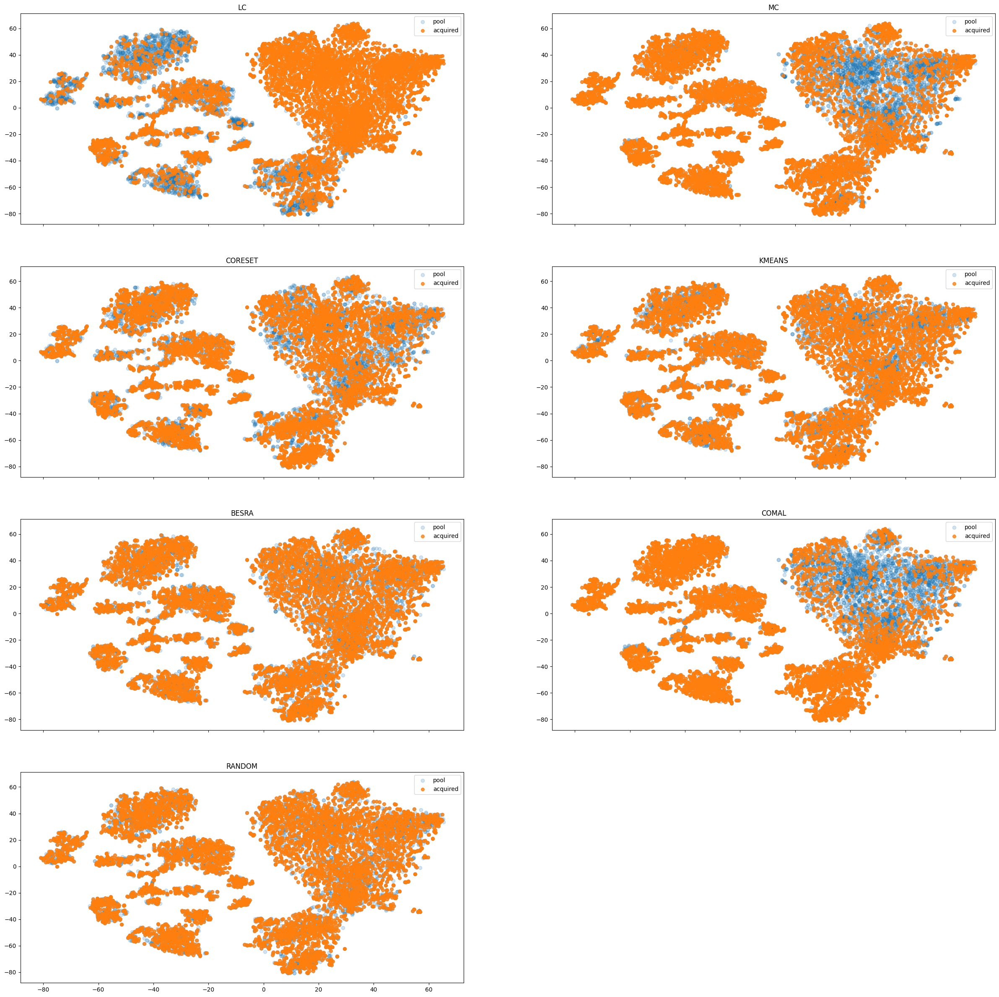

In [16]:
plot_feature_space('hsd', strategies, 0.5)

## POSITIVE SPACE

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


Final KL divergence: 1.3819841146469116
Trustworthiness (0-1): 0.990611501481352
Acquired POSITIVE data count for LC: 2108
Acquired POSITIVE data count for MC: 4887
Acquired POSITIVE data count for Coreset: 3930
Acquired POSITIVE data count for KMeans: 3575
Acquired POSITIVE data count for BESRA: 3714
Acquired POSITIVE data count for CoMAL: 5299
Acquired POSITIVE data count for Random: 3662


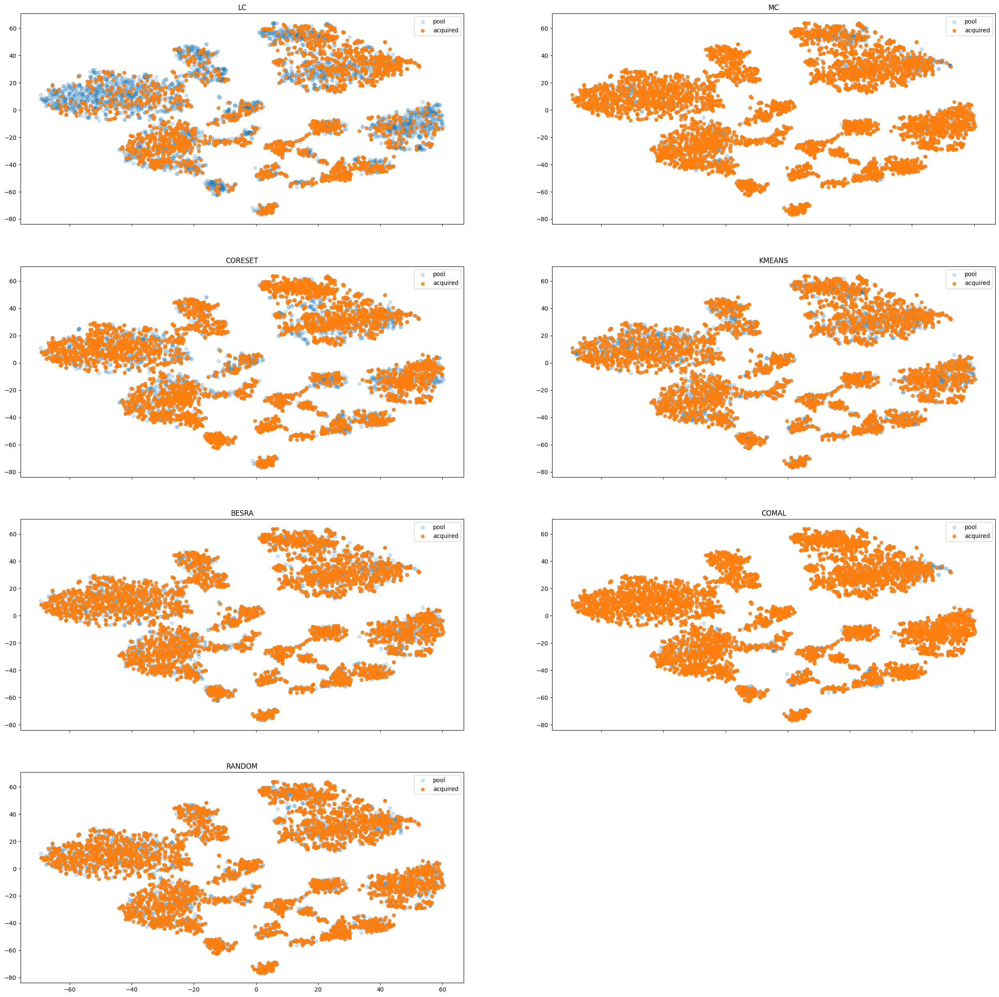

In [11]:
plot_feature_space('hsd', strategies, 0.5)

Final KL divergence: 1.133862853050232
Trustworthiness (0–1): 0.9841661354034238
Acquired POSITIVE data count for LC: 1388
Acquired NEGATIVE data count for LC: 5
Acquired POSITIVE data count for MC: 2472
Acquired NEGATIVE data count for MC: 9
Acquired POSITIVE data count for Coreset: 2616
Acquired NEGATIVE data count for Coreset: 6
Acquired POSITIVE data count for KMeans: 2067
Acquired NEGATIVE data count for KMeans: 4
Acquired POSITIVE data count for BESRA: 2115
Acquired NEGATIVE data count for BESRA: 7
Acquired POSITIVE data count for CoMAL: 2942
Acquired NEGATIVE data count for CoMAL: 9
Acquired POSITIVE data count for Random: 2196
Acquired NEGATIVE data count for Random: 6


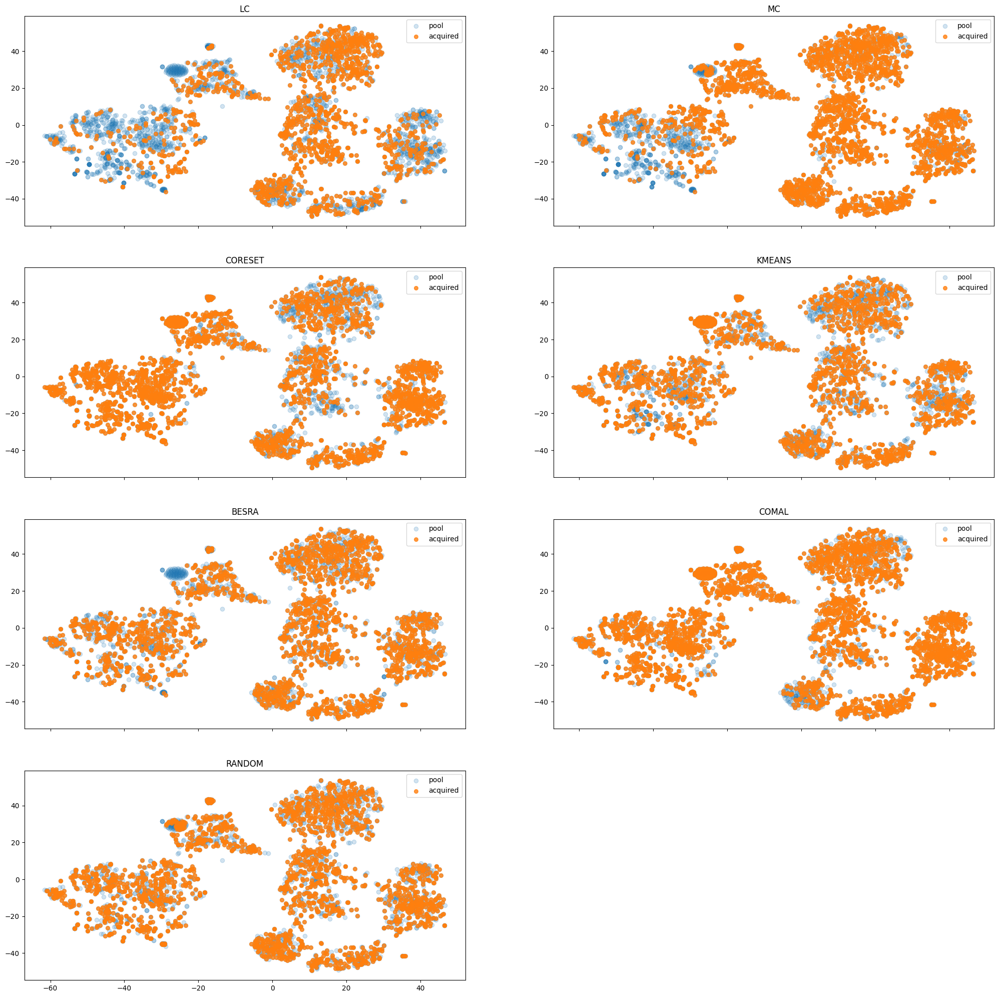

In [ ]:
plot_feature_space('netifier', strategies, 0.5)

Final KL divergence: 0.7995712161064148
Trustworthiness (0–1): 0.92875
Acquired data count for LC: 250
Acquired data count for MC: 250
Acquired data count for Coreset: 250
Acquired data count for KMeans: 250
Acquired data count for BESRA: 244
Acquired data count for CoMAL: 250
Acquired data count for Random: 250


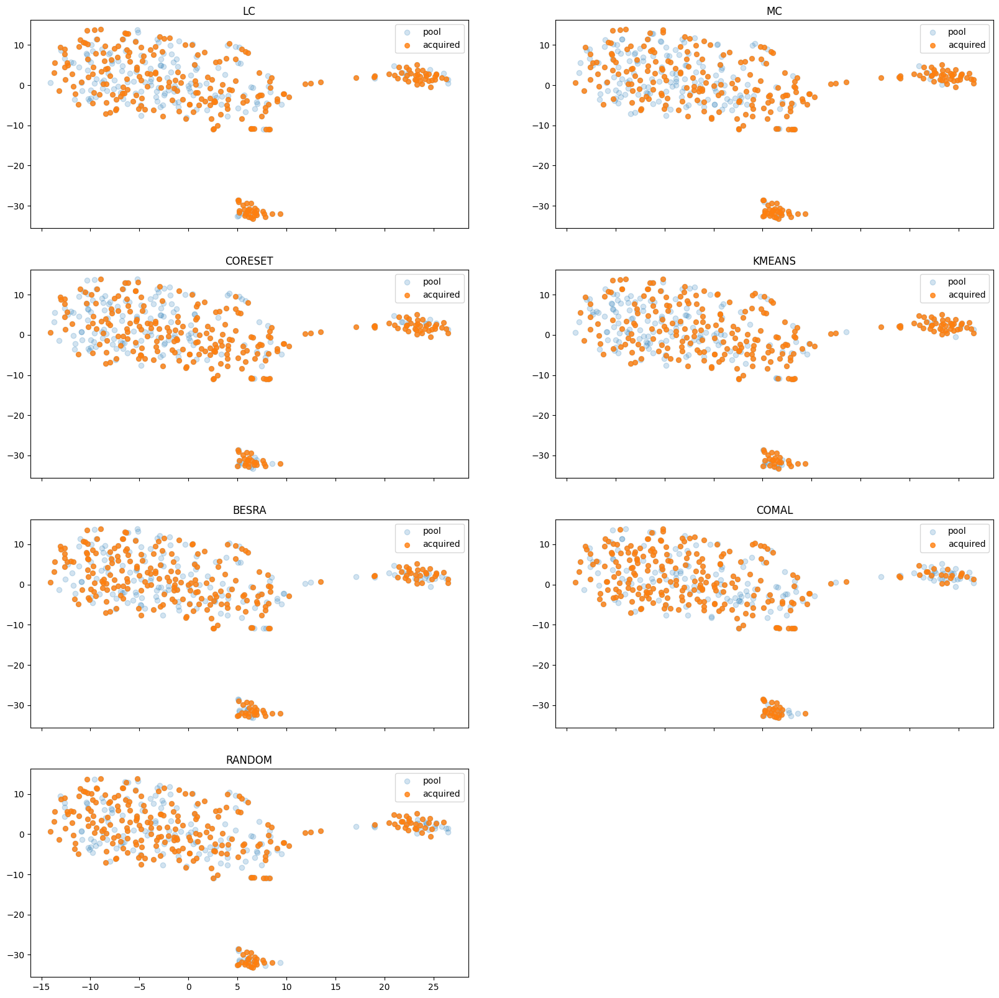

In [ ]:
plot_feature_space('dat', strategies, 0.5)

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


Final KL divergence: 0.5267778635025024
Trustworthiness (0-1): 0.9864385925060575
Acquired POSITIVE data count for LC: 540
Acquired POSITIVE data count for MC: 541
Acquired POSITIVE data count for Coreset: 540
Acquired POSITIVE data count for KMeans: 531
Acquired POSITIVE data count for BESRA: 523
Acquired POSITIVE data count for CoMAL: 540
Acquired POSITIVE data count for Random: 540


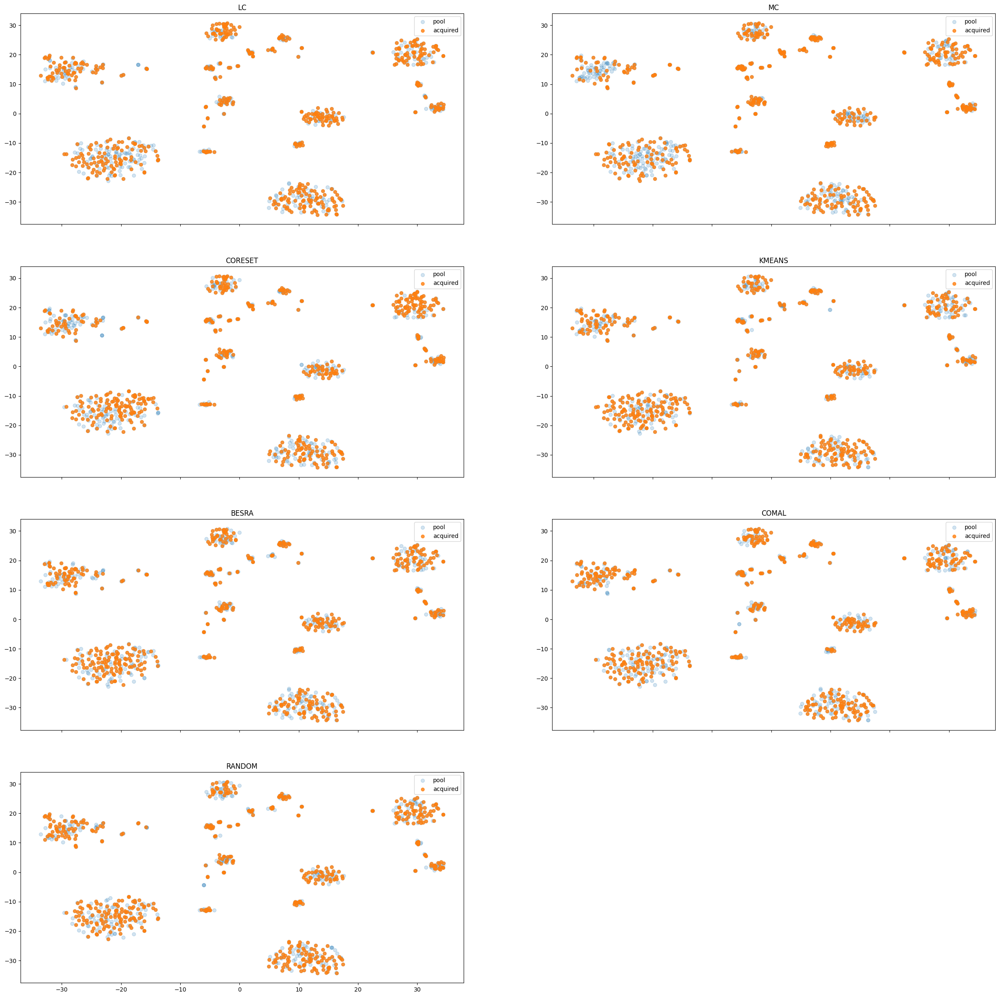

In [ ]:
plot_absa_feature_space('casa', strategies, 0.5)

Final KL divergence: 0.6756657361984253
Trustworthiness (0-1): 0.9951608689164537
Acquired POSITIVE data count for LC: 1427
Acquired POSITIVE data count for MC: 1427
Acquired POSITIVE data count for Coreset: 1427
Acquired POSITIVE data count for KMeans: 1394
Acquired POSITIVE data count for BESRA: 1396
Acquired POSITIVE data count for CoMAL: 1427
Acquired POSITIVE data count for Random: 1427


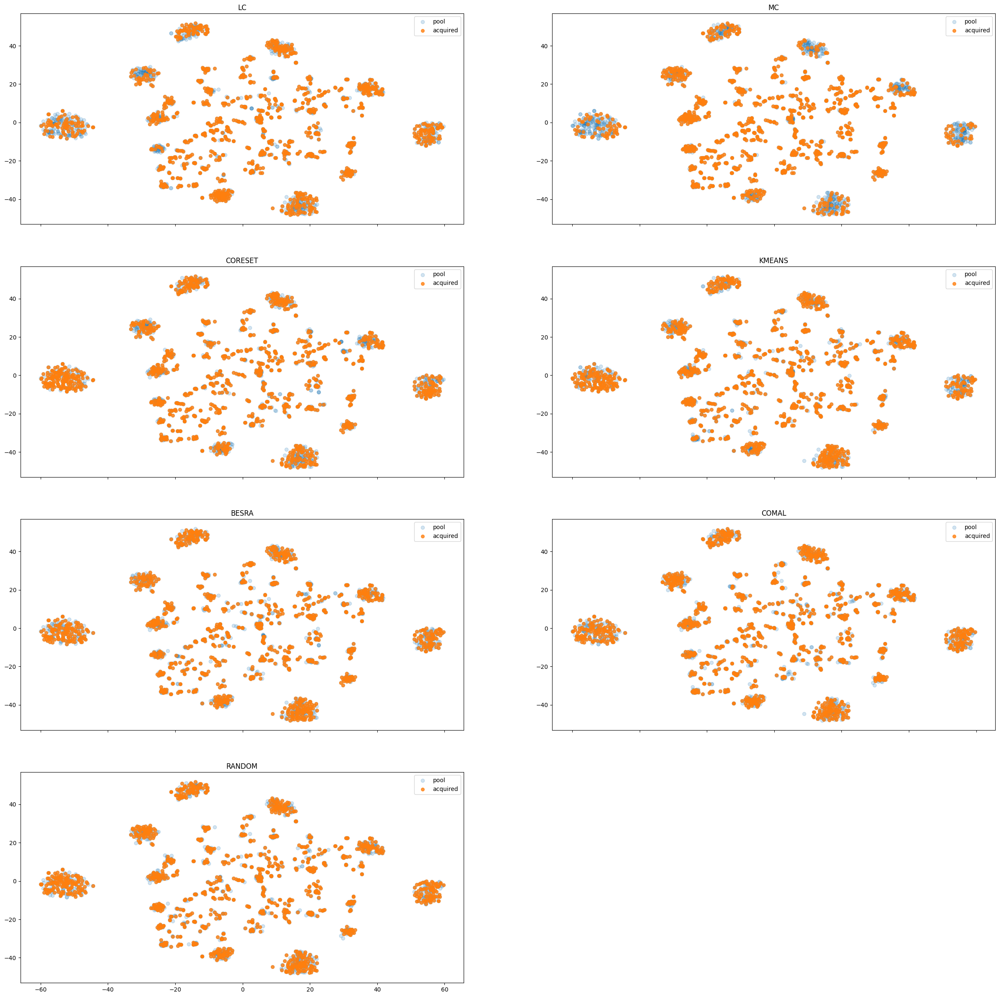

In [ ]:
plot_absa_feature_space('hoasa', strategies, 0.5)

## NEGATIVE SPACES

Final KL divergence: 2.227100133895874
Trustworthiness (0–1): 0.9111437273985183
Acquired NEGATIVE data count for LC: 4476
Acquired NEGATIVE data count for MC: 1697
Acquired NEGATIVE data count for Coreset: 2654
Acquired NEGATIVE data count for KMeans: 2839
Acquired NEGATIVE data count for BESRA: 2697
Acquired NEGATIVE data count for CoMAL: 1285
Acquired NEGATIVE data count for Random: 2922


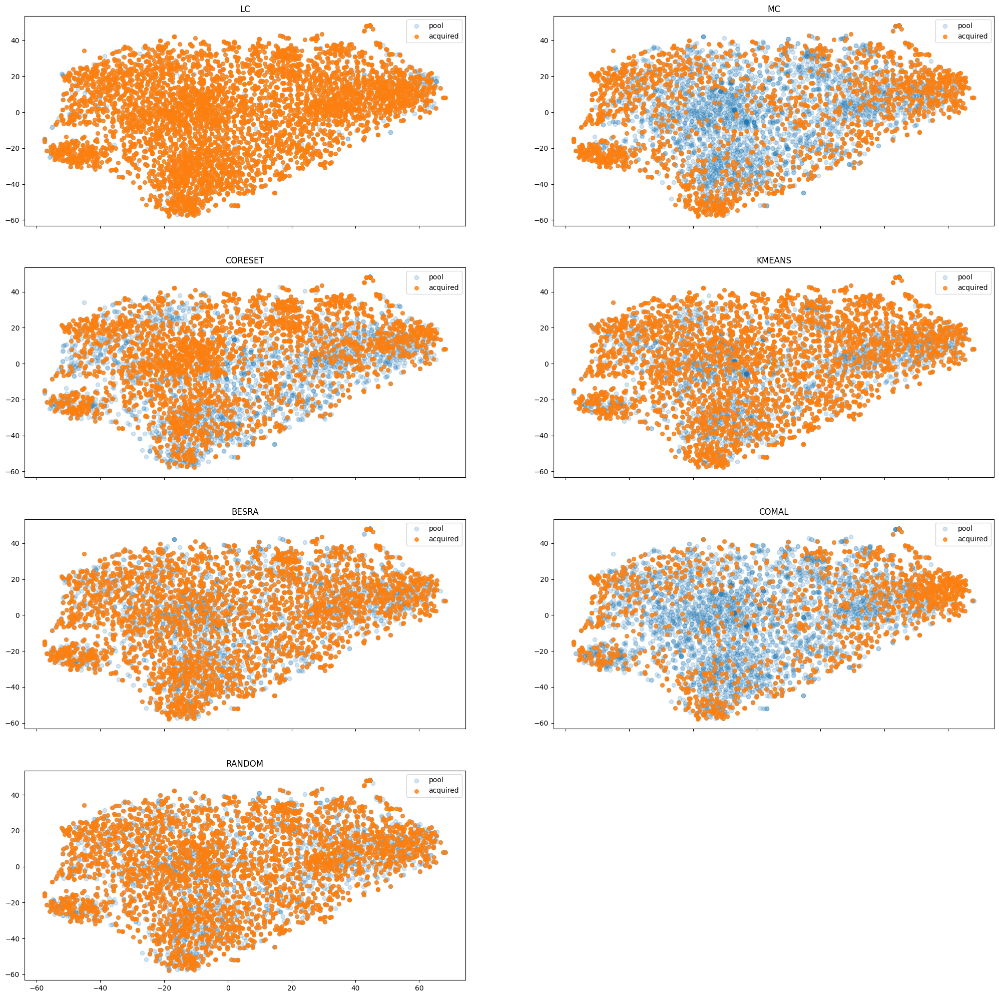

In [13]:
plot_feature_space('hsd', strategies, 0.5)

# PLOT CONTRASTIVE SPACE FOR COMAL

In [61]:
import torch
import torch.nn as nn
from transformers import BertModel, BertConfig
import torch.nn.functional as F
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from transformers import AutoTokenizer, AutoModel, BertForSequenceClassification
import torch
from sklearn.manifold import TSNE
from sklearn.manifold import trustworthiness

class IndoBERT_Backbone(nn.Module):
    def __init__(self, label_num):
        super(IndoBERT_Backbone, self).__init__()
        self.label_num = label_num
        self.encoder = IndoBERT_Encoder(label_num)
        model_config = BertConfig.from_pretrained("indobenchmark/indobert-base-p1")
        self.clf = nn.Linear(model_config.hidden_size, label_num)
        nn.init.xavier_uniform_(self.clf.weight)

    def forward(self, inputs):
        encoder_out = self.encoder(inputs)
        out = self.clf(encoder_out)
        return out, encoder_out

class IndoBERT_Encoder(nn.Module):
    def __init__(self, label_num):
        super(IndoBERT_Encoder, self).__init__()
        self.label_num = label_num
        self.encoder = BertModel.from_pretrained(
            'indobenchmark/indobert-base-p1',
            num_labels=self.label_num,
        )
        self.encoder_init()

    def encoder_init(self):
        all_layers = ['embeddings', 'layer.0', 'layer.1', 'layer.2', 'layer.3', 'layer.4', 'layer.5', 'layer.6',
                      'layer.7', 'layer.8', 'layer.9', 'layer.10', 'layer.11', 'pooler']
        unfreeze_layers = all_layers[7:]
        for name, param in self.encoder.named_parameters():
            param.requires_grad = False
            for ele in unfreeze_layers:
                if ele in name:
                    param.requires_grad = True
                    break

    def forward(self, inputs):
        input_ids = torch.tensor(inputs[0]) if not isinstance(inputs[0], torch.Tensor) else inputs[0]
        token_type_ids = torch.tensor(inputs[1]) if not isinstance(inputs[1], torch.Tensor) else inputs[1]
        attention_mask = torch.tensor(inputs[2]) if not isinstance(inputs[2], torch.Tensor) else inputs[2]
        
        input_ids = input_ids.view(-1, input_ids.size(-1))
        token_type_ids = token_type_ids.view(input_ids.size(0), -1)
        attention_mask = attention_mask.view(-1, attention_mask.size(-1))
        
        outputs = self.encoder(
            input_ids=input_ids,
            token_type_ids=token_type_ids,
            attention_mask=attention_mask,
        )
        return outputs.pooler_output
    
class MLP_VAE(nn.Module):
    def __init__(self, hidden_size, device, label_num):
        super(MLP_VAE, self).__init__()
        self.device = device
        self.label_num = label_num
        self.cl_neg_mode = 1
        self.proto_size = 256
        self.hidden_size = hidden_size
        
        # Initial fully connected layer to project input to higher-dimensional space for each label
        self.fc0 = nn.Linear(self.hidden_size, self.label_num * 512)
        self.fc1 = nn.Linear(512, self.proto_size)  # Dimensionality reduction for prototypes

        # Adjust the number of label representations based on contrastive learning mode
        if self.cl_neg_mode == 0:
            cl_label_num = self.label_num  # Standard label number
        elif self.cl_neg_mode == 1:
            cl_label_num = self.label_num + 1  # Add one for negative prototype handling
            self.ins_neg_cnt = torch.zeros(1).to(device)
        elif self.cl_neg_mode == 2:
            cl_label_num = self.label_num * 2  # Double for positive and negative prototypes
            self.ins_neg_cnt = torch.zeros(self.label_num).to(device)
        self.cl_label_num = cl_label_num

        # Register buffer for label prototypes, aligned with CoMAL's prototype-based sampling
        self.register_buffer("prototypes", torch.zeros(self.cl_label_num, self.proto_size))
        self.ins_pos_cnt = torch.zeros(self.label_num).to(device)  # Track count of positive instances

        # Decoder and final aggregation layers
        self.fc3 = nn.Linear(self.proto_size, 512)
        self.agg = nn.Linear(self.label_num * 512, self.hidden_size)
        self.clf = nn.Linear(self.hidden_size, self.label_num)  # Classification layer

    def get_protos(self):
        return self.prototypes  # Return the prototypes for external use

    def reparameterize(self, mu, logvar):
        # VAE reparameterization trick for latent space sampling
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        return mu + eps * std

    def reset_proto(self):
        # Reset prototype and count buffers
        self.ins_pos_cnt *= 0
        self.ins_neg_cnt *= 0
        self.prototypes *= 0

    def forward(self, x, labels=None, weights=None, reset_proto=False):
        if reset_proto:
            self.reset_proto()
        
        # Project input into sub-representations per label
        sub_rep_ori = self.fc0(x)
        sr_shape = sub_rep_ori.shape
        sub_rep_ori = sub_rep_ori.view(sr_shape[0], self.label_num, -1)  # Split per label

        # Further reduction to prototype size and decoding step
        sub_rep = self.fc1(sub_rep_ori)
        dec_sub_rep = self.fc3(sub_rep)

        dist_1 = None
        sub_rep_norm = F.normalize(sub_rep.data, dim=-1)  # Normalize for distance calculations

        if labels is not None and weights is not None:
            # Generate masks for positive and negative samples
            pos_mask = labels * weights
            neg_mask = (1 - labels) * weights
            pos_mask = pos_mask.unsqueeze(-1)
            neg_mask = neg_mask.unsqueeze(-1)

            # Update positive instance counts
            self.ins_pos_cnt += torch.sum(pos_mask.squeeze(-1), dim=0)

            # Update prototypes based on positive and negative samples
            feat = torch.sum(sub_rep_norm * pos_mask, dim=0)
            self.prototypes[:self.label_num] = self.prototypes[:self.label_num] * self.ins_pos_cnt.unsqueeze(-1) + feat

            # Handle different contrastive learning modes
            if self.cl_neg_mode == 2:
                feat_neg = torch.sum(sub_rep_norm * neg_mask, dim=0)
                self.ins_neg_cnt += torch.sum(neg_mask.squeeze(-1), dim=0)
                self.prototypes[self.label_num:] = self.prototypes[self.label_num:] * self.ins_neg_cnt.unsqueeze(-1) + feat_neg
            elif self.cl_neg_mode == 1:
                feat_neg = torch.sum(sub_rep_norm * neg_mask, dim=0)
                feat_neg = torch.sum(feat_neg, dim=0)
                self.ins_neg_cnt += torch.sum(neg_mask)
                self.prototypes[-1] = self.prototypes[-1] * self.ins_neg_cnt + feat_neg
            
            self.prototypes = F.normalize(self.prototypes, p=2, dim=-1)

        # Calculate distances between sub-representations and prototypes
        if self.cl_neg_mode == 2:
            dist_1 = torch.einsum('bld,ld->bl', [sub_rep_norm, self.prototypes[:self.label_num]])
            # print(dist_1[:3])
            dist_neg_1 = torch.einsum('bld,ld->bl', [sub_rep_norm, self.prototypes[self.label_num:]])
            dist_1 = torch.cat([dist_1, dist_neg_1], dim=1)  # Combine distances for positive and negative prototypes

        else:
            dist_1 = sub_rep_norm @ self.prototypes.T  

        # Decode and classify reconstructed input
        concat_sub_rep = dec_sub_rep.contiguous().view(dec_sub_rep.shape[0], -1)
        recon_x = self.agg(concat_sub_rep)
        recon_x_clf = self.clf(recon_x)

        return recon_x, sub_rep, recon_x_clf, dist_1  # Return reconstruction, sub-representation, classification, and distances


In [65]:
def plot_contrastive_space(dataset, percentage, label_num=10, model_index=2):
    hyperparams = get_dataset_hyperparameters(dataset)
    device = torch.device('mps')

    if percentage <= 0.5:
        data_count = int(math.floor(0.5 * hyperparams['data_count']))
    else:
        data_count = int(math.floor(percentage * hyperparams['data_count']))
    max_data_count = int(math.floor(0.8 * hyperparams['data_count']))

    # 1. Load your data
    full_df = pd.read_csv(f"./../{dataset}/acquired_data/{dataset}-lc-1-data-{max_data_count}.csv")

    # 2. Initialize IndoBERT
    tokenizer = AutoTokenizer.from_pretrained("indobenchmark/indobert-base-p1")
    backbone = IndoBERT_Backbone(label_num=label_num)
    backbone.load_state_dict(torch.load(f"./../{dataset}/models/{dataset}-comal-aspect-p1-backbone-{model_index}-{int(percentage * 100)}.pth", map_location=device))
    backbone.to(device)
    backbone.eval()

    model = MLP_VAE(768, torch.device('mps'), label_num=label_num)
    model.load_state_dict(torch.load(f"./../{dataset}/models/{dataset}-comal-aspect-p1-vae-{model_index}-{int(percentage * 100)}.pth", map_location=device))
    model.to(device)
    model.eval()

    def embed_texts(texts, batch_size=64, device="mps"):
        """Extract embeddings for each label dimension separately"""
        all_embs = [[] for _ in range(label_num)]  # One list per label
        
        for i in range(0, len(texts), batch_size):
            batch_texts = texts[i:i+batch_size]
            batch = tokenizer(
                batch_texts, 
                padding=True, 
                truncation=True, 
                return_tensors="pt", 
                max_length=96
            ).to(device)

            batch_input = [batch['input_ids'], batch['token_type_ids'], batch['attention_mask'], None]

            with torch.no_grad():
                _, emb_backbone = backbone(batch_input)
                _, sub_rep, _, _ = model(emb_backbone.to(device))
                
                # sub_rep shape: [batch_size, label_num, proto_size]
                # We want to collect embeddings for each label separately
                for batch_idx in range(sub_rep.shape[0]):
                    for label_idx in range(sub_rep.shape[1]):
                        all_embs[label_idx].append(sub_rep[batch_idx, label_idx].cpu().numpy())
        
        # Convert lists to numpy arrays
        label_embeddings = []
        for label_idx in range(label_num):
            label_embeddings.append(np.vstack(all_embs[label_idx]))
        
        return label_embeddings

    # 3. Compute embeddings
    texts_full = full_df["processed_text"].tolist()
    X_full_by_label = embed_texts(texts_full)

    # Load acquired data
    acq_df = pd.read_csv(f"./../{dataset}/acquired_data/{dataset}-comal-1-data-{data_count}.csv")
    acq_df = acq_df.iloc[:int(math.floor(percentage * hyperparams['data_count']))]
    texts_acq = set(acq_df["processed_text"].tolist())
    
    # Find indices of acquired samples in the full pool
    acq_idx = [i for i, t in enumerate(texts_full) if t in texts_acq]

    # 4. Create subplots for each label
    fig, axes = plt.subplots(2, math.ceil(label_num / 2), figsize=(30, 20))

    for label_idx in range(label_num):
        row = label_idx // math.ceil(label_num / 2)
        col = label_idx % math.ceil(label_num / 2)
        ax = axes[row, col]

        pos_text_df = full_df[full_df[full_df.columns[label_idx+1]] == 'positive']
        pos_texts = set(pos_text_df["processed_text"].tolist())  # Convert to set for faster lookup
        pos_idx = [i for i, t in enumerate(texts_full) if t in pos_texts]

        neg_text_df = full_df[full_df[full_df.columns[label_idx+1]] == 'negative']
        neg_texts = set(neg_text_df["processed_text"].tolist())  # Convert to set for faster lookup
        neg_idx = [i for i, t in enumerate(texts_full) if t in neg_texts]

        neutral_text_df = full_df[full_df[full_df.columns[label_idx+1]] == 'neutral']
        neutral_texts = set(neutral_text_df["processed_text"].tolist())  # Convert
        neutral_idx = [i for i, t in enumerate(texts_full) if t in neutral_texts]
        
        # Get embeddings for this label
        X_label = X_full_by_label[label_idx]
        X_combined = X_label
        
        # 5. Standardize embeddings for this label
        scaler = StandardScaler()
        X_scaled = scaler.fit_transform(X_combined)

        X_data_scaled = X_scaled
        
        # 6. Apply t-SNE
        tsne = TSNE(
            n_components=2,
            perplexity=min(30, len(X_scaled)//4),
            max_iter=1000,
            learning_rate='auto',
            init='pca',
            random_state=42,
            verbose=0
        )
        
        try:
            X_tsne = tsne.fit_transform(X_scaled)
            print(f"Label {label_idx} - Final KL divergence:", tsne.kl_divergence_)

            # Split t-SNE results
            X_data_tsne = X_tsne
            # X_data_tsne = X_tsne[:-len(label_prototypes)]
            # X_proto_tsne = X_tsne[-len(label_prototypes):]
            
            # Calculate trustworthiness
            trust = trustworthiness(X_data_scaled, X_data_tsne, n_neighbors=min(5, len(X_data_scaled)//2))
            print(f"Label {label_idx} - Trustworthiness (0-1):", trust)
            
            # 7. Plot the results
            # Plot all points in the pool
            if pos_idx:
                ax.scatter(X_data_tsne[pos_idx, 0], X_data_tsne[pos_idx, 1], alpha=0.2, label="Positive")
            if neg_idx:
                ax.scatter(X_data_tsne[neg_idx, 0], X_data_tsne[neg_idx, 1], alpha=0.2, label="Negative", c='red')     
            if neutral_idx:
                ax.scatter(X_data_tsne[neutral_idx, 0], X_data_tsne[neutral_idx, 1], alpha=0.2, label="Neutral", c='C1')            

            label_columns = full_df.columns[1:].tolist()
            
            ax.set_title(f'Label {label_columns[label_idx]}')
            ax.legend(fontsize=18, loc='lower right')
            ax.grid(True, alpha=0.3)
            
        except Exception as e:
            print(f"Error processing label {label_idx}: {e}")
            ax.text(0.5, 0.5, f'Error processing\nLabel {label_idx}', 
                   ha='center', va='center', transform=ax.transAxes)
            ax.set_title(f'Label {label_idx} - Error')

    plt.tight_layout()
    plt.show()

In [66]:
def plot_sentiment_contrastive_space(dataset, percentage, label_num=2, model_index=2):
    hyperparams = get_dataset_hyperparameters(dataset)
    device = torch.device('mps')

    if percentage <= 0.5:
        data_count = int(math.floor(0.5 * hyperparams['data_count']))
    else:
        data_count = int(math.floor(percentage * hyperparams['data_count']))
    max_data_count = int(math.floor(0.8 * hyperparams['data_count']))

    # 1. Load your data
    full_df = pd.read_csv(f"./../{dataset}/acquired_data/{dataset}-lc-1-data-{max_data_count}.csv")
    new_data = []

    for i in full_df.iterrows():
        data = i[1]

        for label in data[1:]:
            if label != 'neut':
                new_data.append({
                    'processed_text': data['processed_text'],
                    'label': label
                })
    
    full_df = pd.DataFrame(new_data)

    # 2. Initialize IndoBERT
    tokenizer = AutoTokenizer.from_pretrained("indobenchmark/indobert-base-p1")
    review_token = '[REVIEW]'
    aspect_token = '[ASPECT]'
    special_tokens_dict = {'additional_special_tokens': [review_token, aspect_token]}
    num_added_tokens = tokenizer.add_special_tokens(special_tokens_dict)

    backbone = IndoBERT_Backbone(label_num=label_num)
    backbone.load_state_dict(torch.load(f"./../{dataset}/models/{dataset}-comal-sentiment-p1-backbone-{model_index}-{int(percentage * 100)}.pth", map_location=device))
    backbone.to(device)
    backbone.eval()

    model = MLP_VAE(768, torch.device('mps'), label_num=label_num)
    model.load_state_dict(torch.load(f"./../{dataset}/models/{dataset}-comal-sentiment-p1-vae-{model_index}-{int(percentage * 100)}.pth", map_location=device))
    model.to(device)
    model.eval()

    def embed_texts(texts, batch_size=64, device="mps"):
        """Extract embeddings for each label dimension separately"""
        all_embs = [[] for _ in range(label_num)]  # One list per label
        
        for i in range(0, len(texts), batch_size):
            batch_texts = texts[i:i+batch_size]

            batch = tokenizer(
                batch_texts, 
                padding=True, 
                truncation=True, 
                return_tensors="pt", 
                max_length=96
            ).to(device)

            batch_input = [batch['input_ids'], batch['token_type_ids'], batch['attention_mask'], None]

            with torch.no_grad():
                _, emb_backbone = backbone(batch_input)
                _, sub_rep, _, _ = model(emb_backbone.to(device))
                
                # sub_rep shape: [batch_size, label_num, proto_size]
                # We want to collect embeddings for each label separately
                for batch_idx in range(sub_rep.shape[0]):
                    for label_idx in range(sub_rep.shape[1]):
                        all_embs[label_idx].append(sub_rep[batch_idx, label_idx].cpu().numpy())
        
        # Convert lists to numpy arrays
        label_embeddings = []
        for label_idx in range(label_num):
            label_embeddings.append(np.vstack(all_embs[label_idx]))
        
        return label_embeddings

    # 3. Compute embeddings
    texts_full = full_df["processed_text"].tolist()
    X_full_by_label = embed_texts(texts_full)

    # Load acquired data
    acq_df = pd.read_csv(f"./../{dataset}/acquired_data/{dataset}-comal-1-data-{data_count}.csv")
    new_data = []
    for i in acq_df.iterrows():
        data = i[1]

        for label in data[1:]:
            if label != 'neut':
                new_data.append({
                    'processed_text': data['processed_text'],
                    'label': label
                })
    acq_df = pd.DataFrame(new_data)

    # acq_df = acq_df.iloc[:int(math.floor(percentage * hyperparams['data_count']))]
    # texts_acq = set(acq_df["processed_text"].tolist())

    # 4. Create subplots for each label
    fig, axes = plt.subplots(1, 2, figsize=(20, 10))

    for label_idx in range(2):
        row = label_idx // 2
        col = label_idx % 2
        ax = axes[col]

        if dataset == 'casa':
            pos_label = 'negative' if label_idx == 0 else 'positive'
            neg_label = 'positive' if label_idx == 0 else 'negative'
        elif dataset == 'hoasa':
            pos_label = 'neg' if label_idx == 0 else 'pos'
            neg_label = 'pos' if label_idx == 0 else 'neg'
        pos_idx = []
        neg_idx = []

        # for i in range(aspect_num):
        for i, data in enumerate(full_df.iterrows()):
            data = data[1]
            if data['label'] == pos_label:
                pos_idx.append(i)
            else:
                neg_idx.append(i)

        pos_idx = list(set(pos_idx))  # Remove duplicates
        neg_idx = list(set(neg_idx))  # Remove duplicates
        
        # Get embeddings for this label
        X_label = X_full_by_label[label_idx]
        X_combined = X_label
        
        # 5. Standardize embeddings for this label
        scaler = StandardScaler()
        X_scaled = scaler.fit_transform(X_combined)
        X_data_scaled = X_scaled
        
        # 6. Apply t-SNE
        tsne = TSNE(
            n_components=2,
            perplexity=min(30, len(X_scaled)//4),
            max_iter=1000,
            learning_rate='auto',
            init='pca',
            random_state=42,
            verbose=0
        )
        
        try:
            X_tsne = tsne.fit_transform(X_scaled)
            print(f"Label {label_idx} - Final KL divergence:", tsne.kl_divergence_)

            # Split t-SNE results
            X_data_tsne = X_tsne
            
            # Calculate trustworthiness
            trust = trustworthiness(X_data_scaled, X_data_tsne, n_neighbors=min(5, len(X_data_scaled)//2))
            print(f"Label {label_idx} - Trustworthiness (0-1):", trust)
            
            # 7. Plot the results
            # Plot all points in the pool
            if pos_idx:
                ax.scatter(X_data_tsne[pos_idx, 0], X_data_tsne[pos_idx, 1], alpha=0.2, label=f"Data label is {pos_label}")
            if neg_idx:
                ax.scatter(X_data_tsne[neg_idx, 0], X_data_tsne[neg_idx, 1], alpha=0.2, label=f"Data label is not {pos_label}", c='red')         

            # label_columns = full_df.columns[1:].tolist()
            label_columns = ['Negative', 'Positive'] 
            
            ax.set_title(f'Label {label_columns[label_idx]}')
            ax.legend(fontsize=18, loc='lower right')
            ax.grid(True, alpha=0.3)
            
        except Exception as e:
            print(f"Error processing label {label_idx}: {e}")
            ax.text(0.5, 0.5, f'Error processing\nLabel {label_idx}', 
                   ha='center', va='center', transform=ax.transAxes)
            ax.set_title(f'Label {label_idx} - Error')

    plt.tight_layout()
    plt.show()

## HSD

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


Label 0 - Final KL divergence: 2.061746835708618
Label 0 - Trustworthiness (0-1): 0.9855523056876956
Label 1 - Final KL divergence: 1.9548416137695312
Label 1 - Trustworthiness (0-1): 0.9871823203822079
Label 2 - Final KL divergence: 2.0102996826171875
Label 2 - Trustworthiness (0-1): 0.9858896307003453
Label 3 - Final KL divergence: 2.017066717147827
Label 3 - Trustworthiness (0-1): 0.9857071145145381
Label 4 - Final KL divergence: 2.0201942920684814
Label 4 - Trustworthiness (0-1): 0.9844743480378094
Label 5 - Final KL divergence: 2.072373628616333
Label 5 - Trustworthiness (0-1): 0.9840825713200972
Label 6 - Final KL divergence: 2.089580535888672
Label 6 - Trustworthiness (0-1): 0.9815769128305188
Label 7 - Final KL divergence: 2.062150239944458
Label 7 - Trustworthiness (0-1): 0.9821781105822806
Label 8 - Final KL divergence: 2.016030788421631
Label 8 - Trustworthiness (0-1): 0.9869562540133989
Label 9 - Final KL divergence: 2.0365874767303467
Label 9 - Trustworthiness (0-1): 0.985

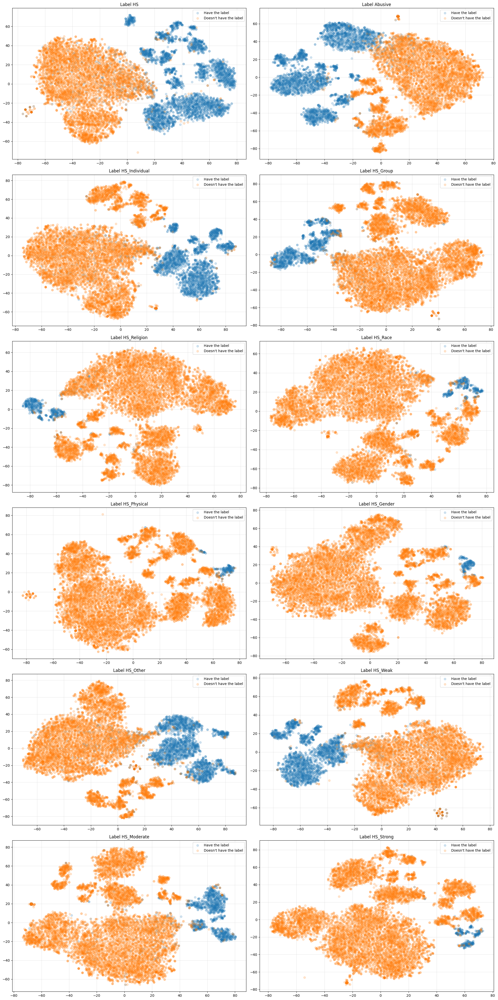

In [14]:
plot_contrastive_space('hsd', 0.5, 12, 1)

## HOASA

Label 0 - Final KL divergence: 1.1106226444244385
Label 0 - Trustworthiness (0-1): 0.9885165172103412
Label 1 - Final KL divergence: 1.1725962162017822
Label 1 - Trustworthiness (0-1): 0.9893853566494828
Label 2 - Final KL divergence: 1.155430555343628
Label 2 - Trustworthiness (0-1): 0.9888117139102685
Label 3 - Final KL divergence: 1.1930177211761475
Label 3 - Trustworthiness (0-1): 0.9878169557118309
Label 4 - Final KL divergence: 1.0891618728637695
Label 4 - Trustworthiness (0-1): 0.9931943798645507
Label 5 - Final KL divergence: 1.1447391510009766
Label 5 - Trustworthiness (0-1): 0.9916785798520358
Label 6 - Final KL divergence: 1.074739933013916
Label 6 - Trustworthiness (0-1): 0.9933186428114155
Label 7 - Final KL divergence: 1.2048776149749756
Label 7 - Trustworthiness (0-1): 0.9882358762569012
Label 8 - Final KL divergence: 1.2078111171722412
Label 8 - Trustworthiness (0-1): 0.9851058516603852
Label 9 - Final KL divergence: 1.1342345476150513
Label 9 - Trustworthiness (0-1): 0

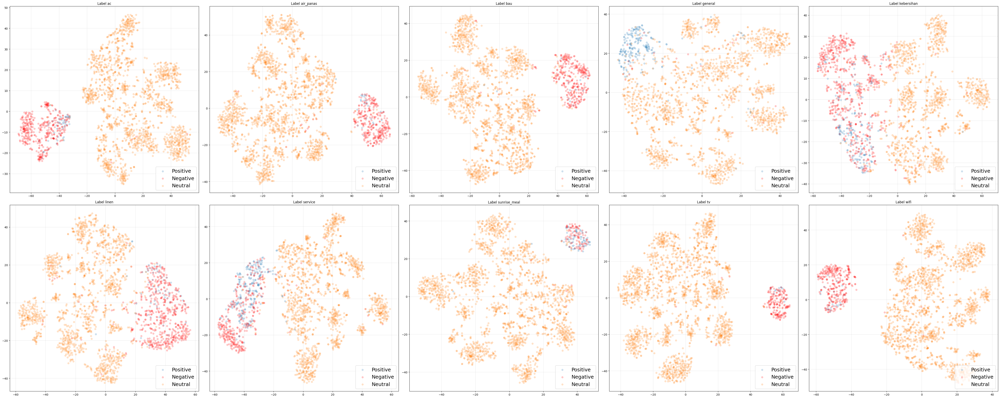

In [57]:
# ASPECT MODEL
plot_contrastive_space('hoasa', 0.5, 10, 2)

Label 0 - Final KL divergence: 1.0297462940216064
Label 0 - Trustworthiness (0-1): 0.9907663812315586
Label 1 - Final KL divergence: 1.121880292892456
Label 1 - Trustworthiness (0-1): 0.9908569503208137
Label 2 - Final KL divergence: 1.0741479396820068
Label 2 - Trustworthiness (0-1): 0.9902582008442719
Label 3 - Final KL divergence: 1.1425201892852783
Label 3 - Trustworthiness (0-1): 0.988070641579183
Label 4 - Final KL divergence: 1.0011751651763916
Label 4 - Trustworthiness (0-1): 0.9935222692331759
Label 5 - Final KL divergence: 1.0209156274795532
Label 5 - Trustworthiness (0-1): 0.993090756812176
Label 6 - Final KL divergence: 1.0084809064865112
Label 6 - Trustworthiness (0-1): 0.9940570196338921
Label 7 - Final KL divergence: 1.1734750270843506
Label 7 - Trustworthiness (0-1): 0.9890447983903963
Label 8 - Final KL divergence: 1.121001958847046
Label 8 - Trustworthiness (0-1): 0.9877406728182024
Label 9 - Final KL divergence: 1.0824029445648193
Label 9 - Trustworthiness (0-1): 0.9

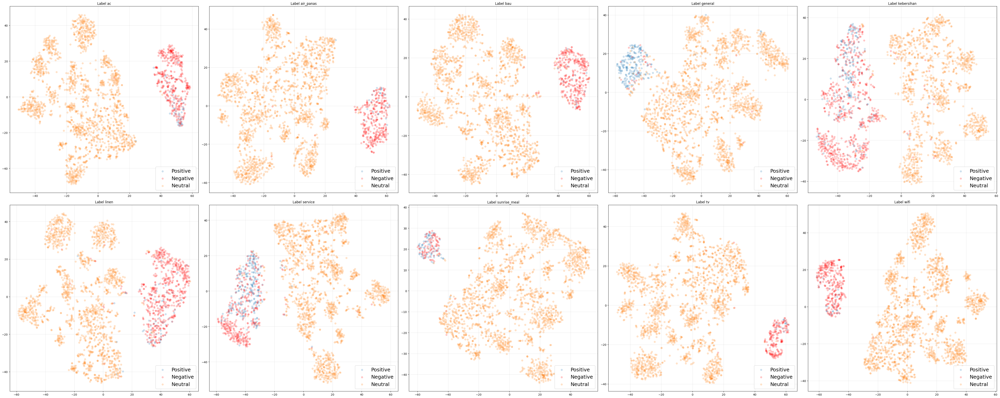

In [58]:
# ASPECT MODEL
plot_contrastive_space('hoasa', 0.6, 10, 2)

Label 0 - Final KL divergence: 0.785557210445404
Label 0 - Trustworthiness (0-1): 0.9935180227965609
Label 1 - Final KL divergence: 0.8203941583633423
Label 1 - Trustworthiness (0-1): 0.9923094925250642


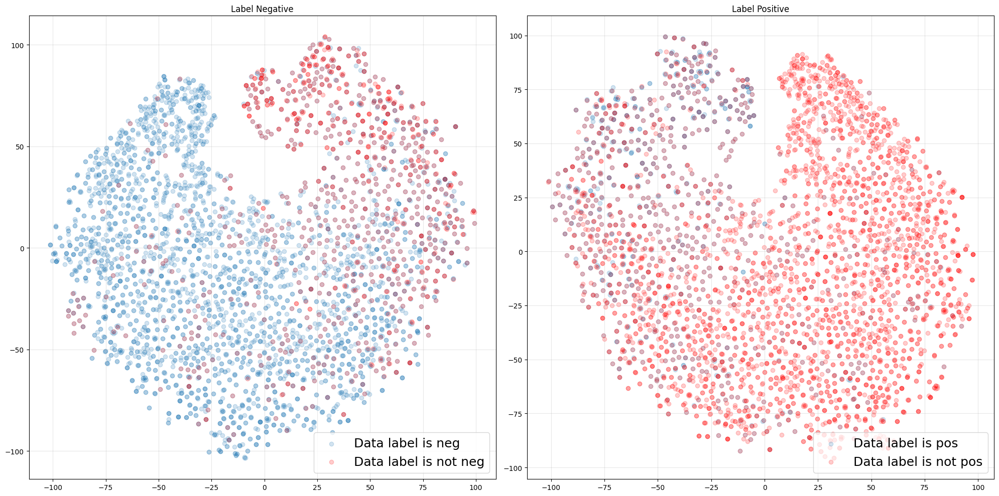

In [59]:
# SENTIMENT MODEL
plot_sentiment_contrastive_space('hoasa', 0.5, 2, 2)

Label 0 - Final KL divergence: 0.7814487218856812
Label 0 - Trustworthiness (0-1): 0.9928630184617713
Label 1 - Final KL divergence: 0.8616323471069336
Label 1 - Trustworthiness (0-1): 0.9895907650281482


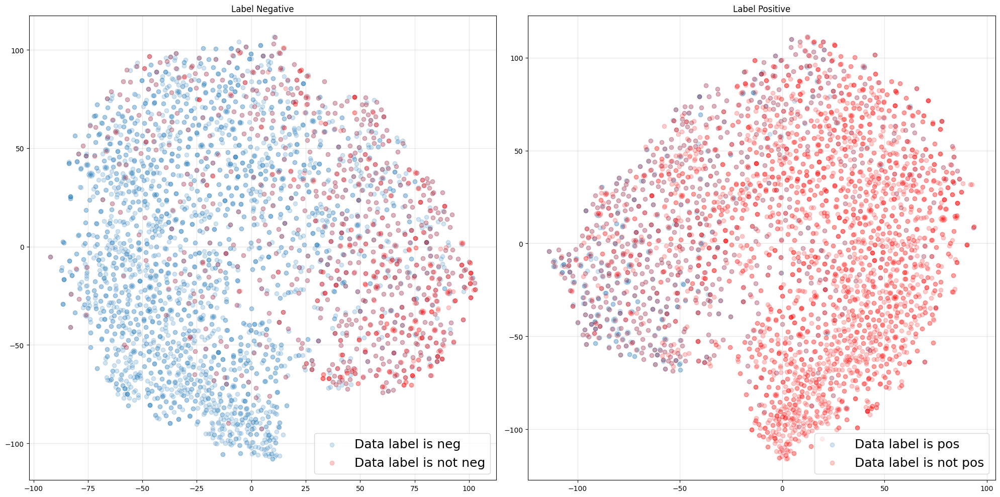

In [60]:
# SENTIMENT MODEL
plot_sentiment_contrastive_space('hoasa', 0.6, 2, 2)

## CASA

Label 0 - Final KL divergence: 0.7428882122039795
Label 0 - Trustworthiness (0-1): 0.980307848736587
Label 1 - Final KL divergence: 0.7710383534431458
Label 1 - Trustworthiness (0-1): 0.9800290433541018
Label 2 - Final KL divergence: 0.8085336685180664
Label 2 - Trustworthiness (0-1): 0.9815769405503635
Label 3 - Final KL divergence: 0.75173020362854
Label 3 - Trustworthiness (0-1): 0.9836464823468328
Label 4 - Final KL divergence: 0.7804612517356873
Label 4 - Trustworthiness (0-1): 0.9809482087227415
Label 5 - Final KL divergence: 0.7914944291114807
Label 5 - Trustworthiness (0-1): 0.9796434211664936


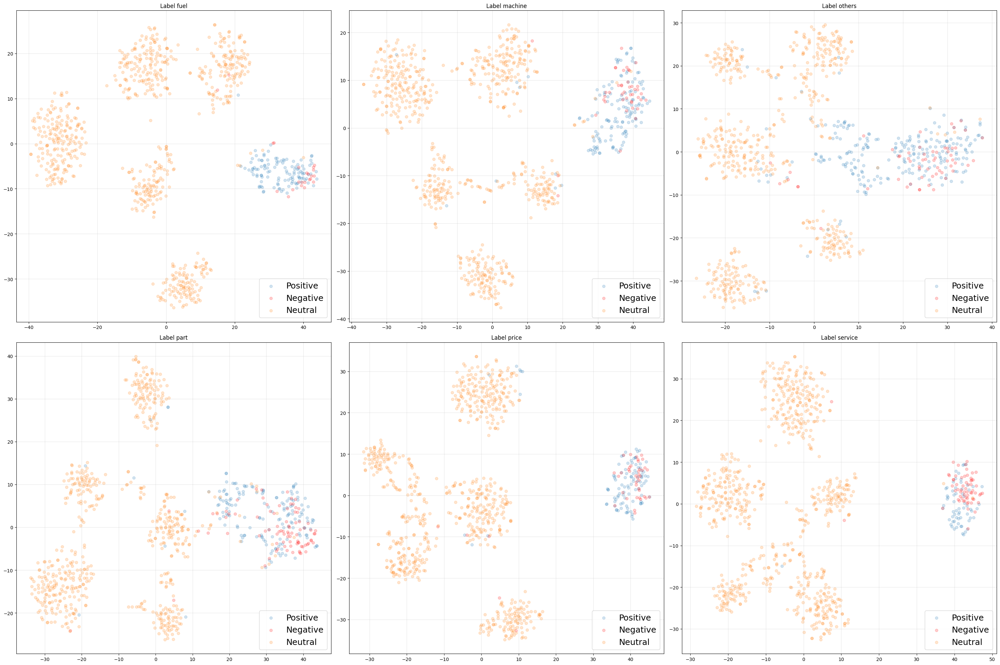

In [67]:
# ASPECT MODEL
plot_contrastive_space('casa', 0.5, 6, 5)

Label 0 - Final KL divergence: 0.7454919815063477
Label 0 - Trustworthiness (0-1): 0.9851213655244029
Label 1 - Final KL divergence: 0.7426630854606628
Label 1 - Trustworthiness (0-1): 0.984677602544133
Label 2 - Final KL divergence: 0.7815828919410706
Label 2 - Trustworthiness (0-1): 0.983378764278297
Label 3 - Final KL divergence: 0.7446849346160889
Label 3 - Trustworthiness (0-1): 0.9853220188646591
Label 4 - Final KL divergence: 0.7840292453765869
Label 4 - Trustworthiness (0-1): 0.9812916450328834
Label 5 - Final KL divergence: 0.7709935307502747
Label 5 - Trustworthiness (0-1): 0.9819966359466944


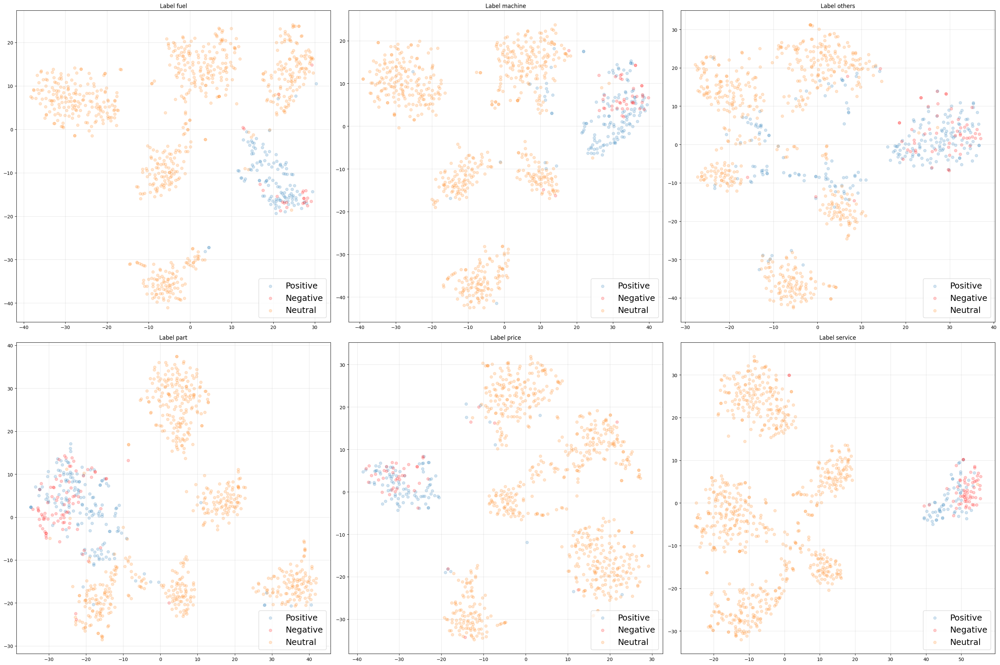

In [68]:
# ASPECT MODEL
plot_contrastive_space('casa', 0.6, 6, 5)

Label 0 - Final KL divergence: -0.13284233212471008
Label 0 - Trustworthiness (0-1): 0.9999990533826588
Label 1 - Final KL divergence: -0.1382003128528595
Label 1 - Trustworthiness (0-1): 0.9999991577341767


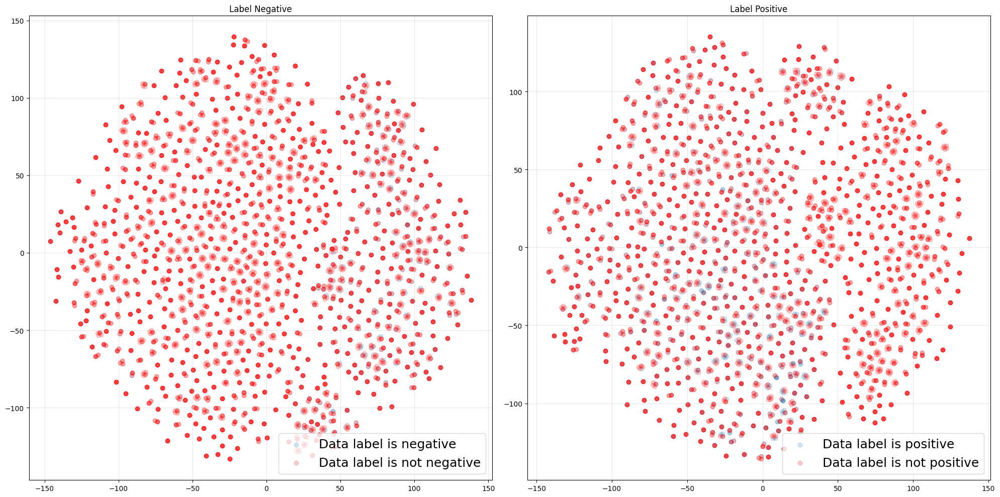

In [69]:
# SENTIMENT MODEL
plot_sentiment_contrastive_space('casa', 0.5, 2, 5)

Label 0 - Final KL divergence: -0.09550962597131729
Label 0 - Trustworthiness (0-1): 0.999999195002576
Label 1 - Final KL divergence: -0.12058150768280029
Label 1 - Trustworthiness (0-1): 0.9999990682900185


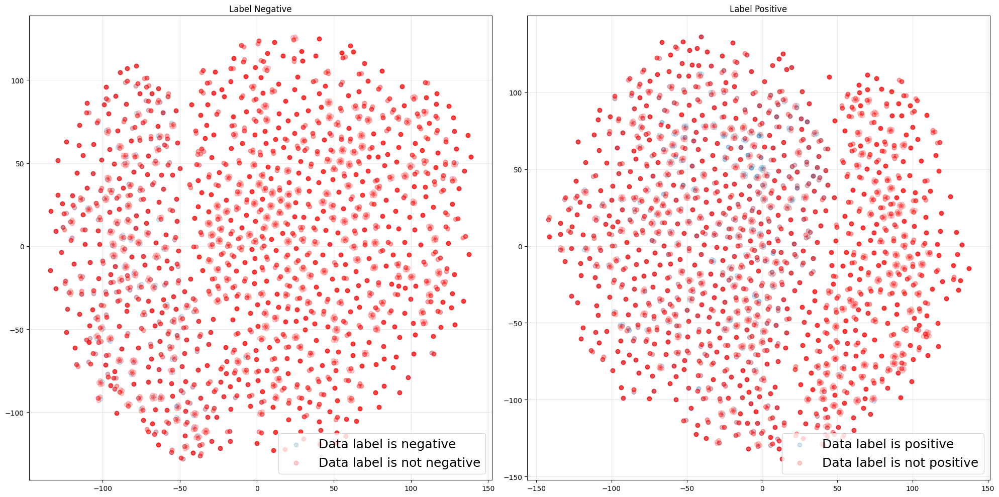

In [70]:
# SENTIMENT MODEL
plot_sentiment_contrastive_space('casa', 0.6, 2, 5)